In [2]:
import os
import warnings
warnings.filterwarnings("ignore")
import json
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import gc

In [5]:
black = '\033[30m'
red = '\033[31m'
green = '\033[32m'
yellow = '\033[33m'
blue = '\033[34m'
magenta = '\033[35m'
cyan = '\033[36m'
white = '\033[37m'
orange = "\033[38;5;208m"
bold = '\033[1m'
reset = '\033[0m'


In [3]:
from google.colab import drive
drive.mount('/content/drive')
folder_path = '/content/drive/MyDrive/Florida-Coral-Reef'
os.chdir(folder_path)


ModuleNotFoundError: No module named 'google'

## Analyze the evolution of stony coral percentage cover across different stations during the study period

In [3]:
path = "dataset/"
df= pd.read_csv(path+'CREMP_Pcover_2023_StonyCoralSpecies.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3918 entries, 0 to 3917
Data columns (total 50 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   OID_                               3918 non-null   int64  
 1   Year                               3918 non-null   int64  
 2   Date                               3912 non-null   object 
 3   Subregion                          3918 non-null   object 
 4   Habitat                            3918 non-null   object 
 5   SiteID                             3918 non-null   int64  
 6   Site_name                          3918 non-null   object 
 7   StationID                          3918 non-null   int64  
 8   Surveyed_all_years                 3918 non-null   object 
 9   points                             3918 non-null   int64  
 10  Acropora_cervicornis               3918 non-null   float64
 11  Acropora_palmata                   3918 non-null   float

In [25]:
df['StationID'].nunique()

184

In [31]:
# Site_name
df['Site_name'].nunique()


46

In [32]:
df['SiteID'].nunique()


46

In [23]:
grouped_data

,Year,StationID,points,Acropora_cervicornis,Acropora_palmata,Agaricia_fragilis,Agaricia_lamarcki,Cladocora_arbuscula,Colpophyllia_natans,Dendrogyra_cylindrus,...,Porites_porites_complex,Pseudodiploria_clivosa,Pseudodiploria_strigosa,Scleractinia,Scolymia_sp,Siderastrea_radians,Siderastrea_siderea,Solenastrea_bournoni,Stephanocoenia_intersepta,Undaria_agaricites_complex
0,1996,101,479.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0,0.0000,0.0000
1,1996,102,525.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0,0.0000,0.0000
2,1996,103,558.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0,0.0000,0.0000
3,1996,104,446.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0,0.0000,0.0000
4,1996,111,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0,0.0000,0.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3913,2023,804,858.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0117,0.0,0.0023,0.0035
3914,2023,811,893.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0146,0.0,0.0034,0.0022
3915,2023,812,920.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0011,0.0,0.0,0.0,0.0,0.0000,0.0076,0.0,0.0022,0.0000
3916,2023,813,858.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0000,0.0,0.0,0.0,0.0,0.0012,0.0000,0.0,0.0000,0.0000


In [4]:
columns = ['points', 'Acropora_cervicornis',
          'Acropora_palmata', 'Agaricia_fragilis', 'Agaricia_lamarcki',
          'Cladocora_arbuscula', 'Colpophyllia_natans', 'Dendrogyra_cylindrus',
          'Dichocoenia_stokesii', 'Diploria_labyrinthiformis',
          'Eusmilia_fastigiata', 'Favia_fragum', 'Helioseris_cucullata',
          'Isophyllia_rigida', 'Isophyllia_sinuosa', 'Madracis_aurentenra',
          'Madracis_decactis_complex', 'Manicina_areolata',
          'Meandrina_meandrites', 'Millepora_alcicornis', 'Millepora_complanata',
          'Montastraea_cavernosa', 'Mussa_angulosa', 'Mycetophyllia_aliciae',
          'Mycetophyllia_ferox', 'Mycetophyllia_lamarckiana_complex',
          'Oculina_diffusa', 'Oculina_robusta', 'Orbicella_annularis_complex',
          'Phyllangia_americana', 'Porites_astreoides', 'Porites_porites_complex',
          'Pseudodiploria_clivosa', 'Pseudodiploria_strigosa', 'Scleractinia',
          'Scolymia_sp', 'Siderastrea_radians', 'Siderastrea_siderea',
          'Solenastrea_bournoni', 'Stephanocoenia_intersepta',
          'Undaria_agaricites_complex','Year', 'Site_name', ]
species = ['Acropora_cervicornis',
          'Acropora_palmata', 'Agaricia_fragilis', 'Agaricia_lamarcki',
          'Cladocora_arbuscula', 'Colpophyllia_natans', 'Dendrogyra_cylindrus',
          'Dichocoenia_stokesii', 'Diploria_labyrinthiformis',
          'Eusmilia_fastigiata', 'Favia_fragum', 'Helioseris_cucullata',
          'Isophyllia_rigida', 'Isophyllia_sinuosa', 'Madracis_aurentenra',
          'Madracis_decactis_complex', 'Manicina_areolata',
          'Meandrina_meandrites', 'Millepora_alcicornis', 'Millepora_complanata',
          'Montastraea_cavernosa', 'Mussa_angulosa', 'Mycetophyllia_aliciae',
          'Mycetophyllia_ferox', 'Mycetophyllia_lamarckiana_complex',
          'Oculina_diffusa', 'Oculina_robusta', 'Orbicella_annularis_complex',
          'Phyllangia_americana', 'Porites_astreoides', 'Porites_porites_complex',
          'Pseudodiploria_clivosa', 'Pseudodiploria_strigosa', 'Scleractinia',
          'Scolymia_sp', 'Siderastrea_radians', 'Siderastrea_siderea',
          'Solenastrea_bournoni', 'Stephanocoenia_intersepta',
          'Undaria_agaricites_complex']

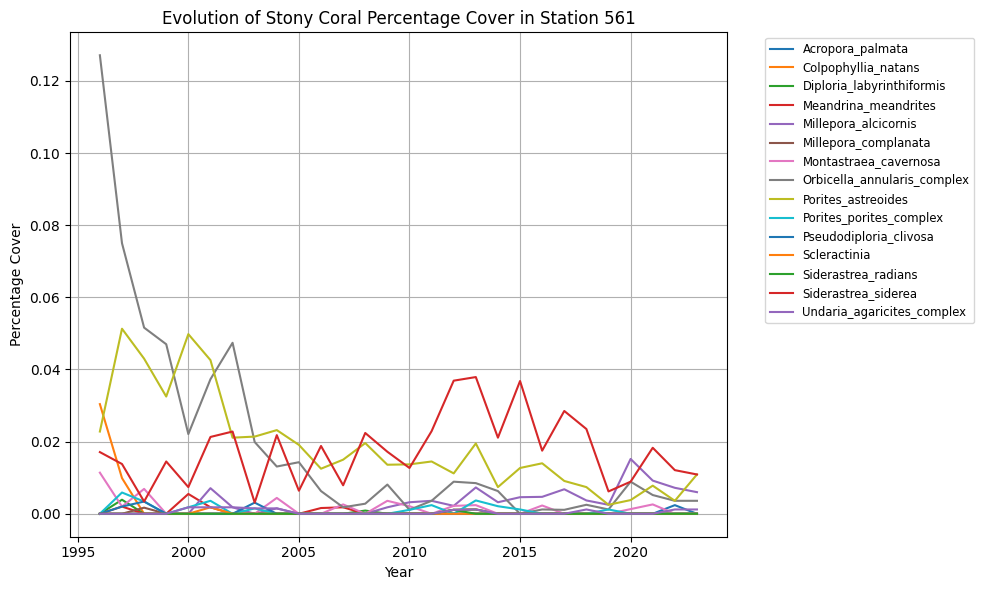

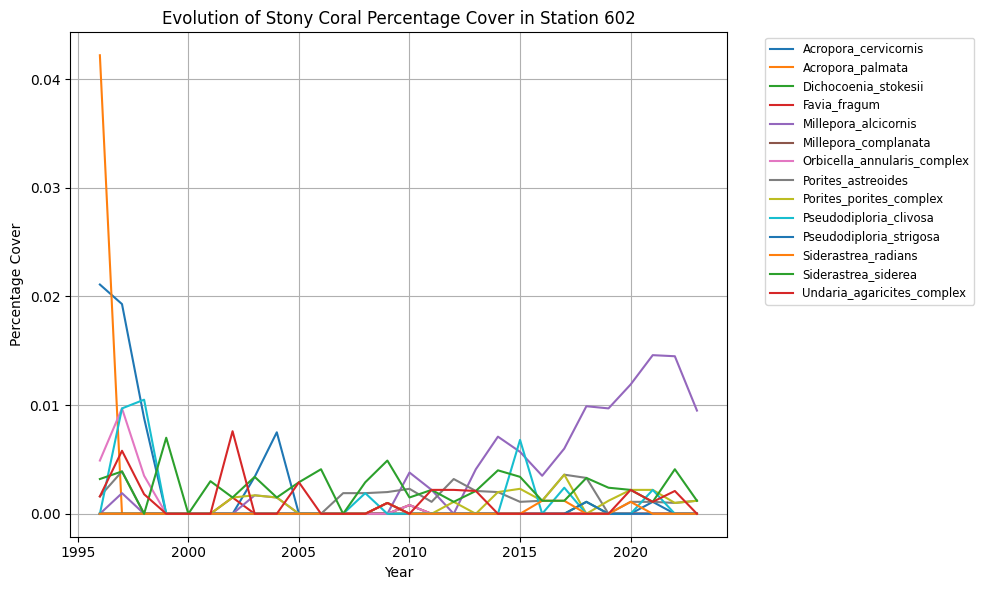

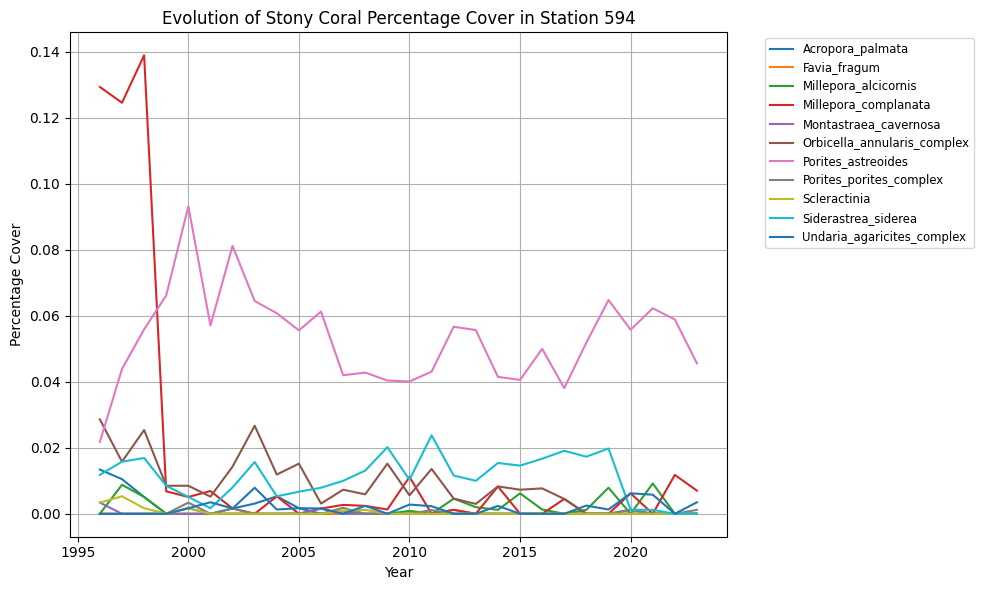

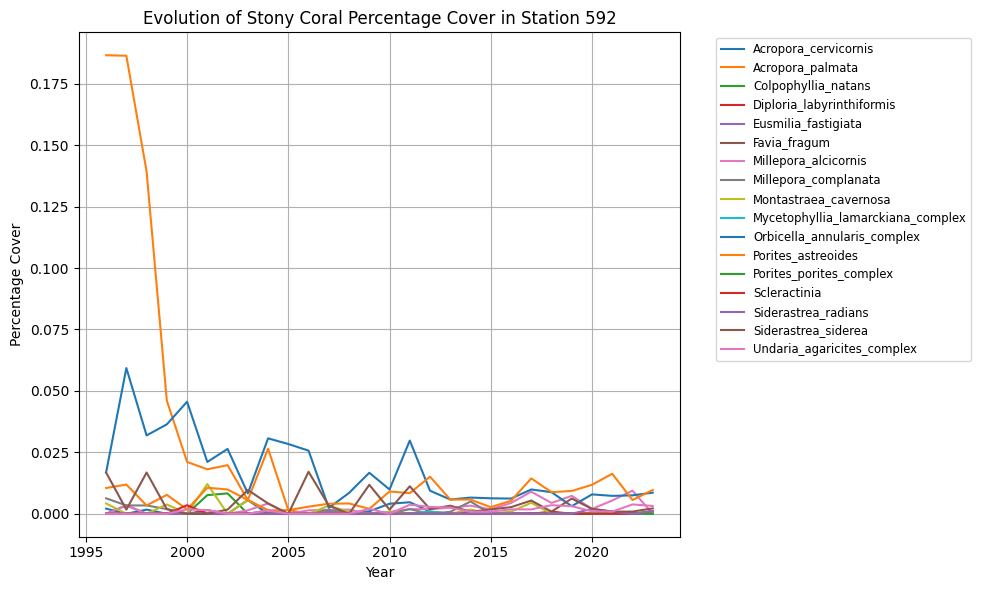

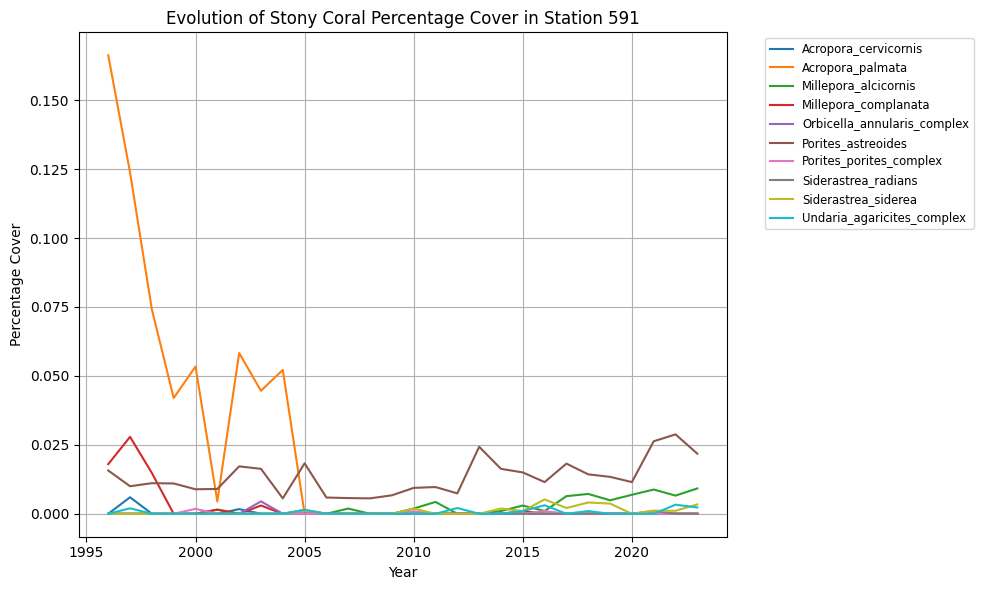

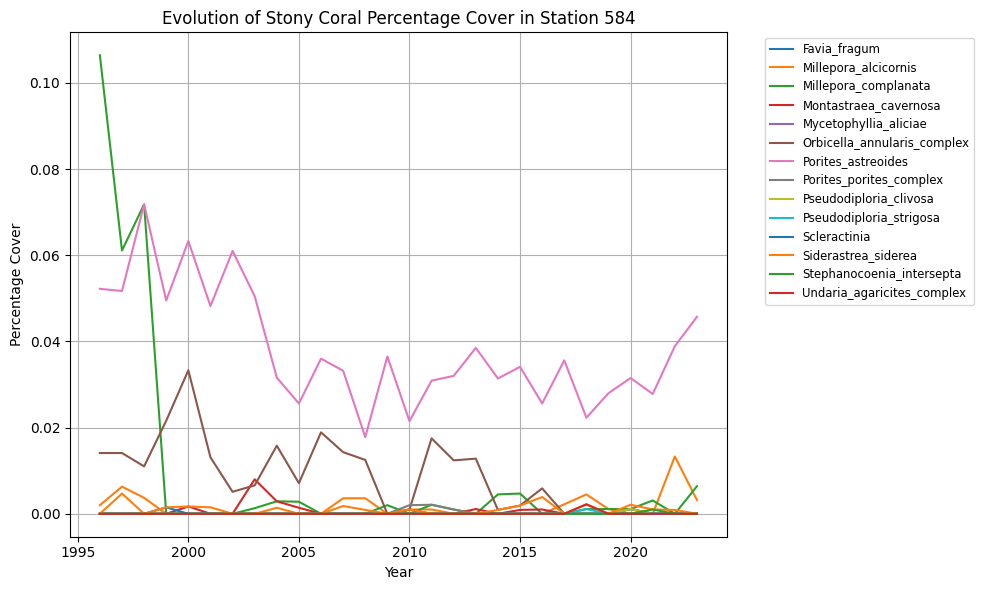

In [ ]:
path = 'dataset/'
df= pd.read_csv(path+'CREMP_Pcover_2023_StonyCoralSpecies.csv')
df.set_index('Date', inplace=True)
df.index = pd.to_datetime(df.index)

grouped_data = df[columns].groupby(['Year', 'StationID']).mean().reset_index()
# Loop through unique stations to plot data for each station
for station in  list(grouped_data['StationID'].value_counts().head(6).index):
    plt.figure(figsize=(10, 6))
    station_data = grouped_data[grouped_data['StationID'] == station]
    for sp in species:
      if (station_data[sp]>0).any():
        plt.plot(
            station_data['Year'],
            station_data[sp],
            label=f'{sp}'
        )
    # Adding titles and labels
    plt.title(f'Evolution of Stony Coral Percentage Cover in Station {station}')
    plt.xlabel('Year')
    plt.ylabel('Percentage Cover')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')  # Adjust legend placement
    plt.grid()
    plt.tight_layout()  # Adjust layout to prevent overlap
    plt.show()

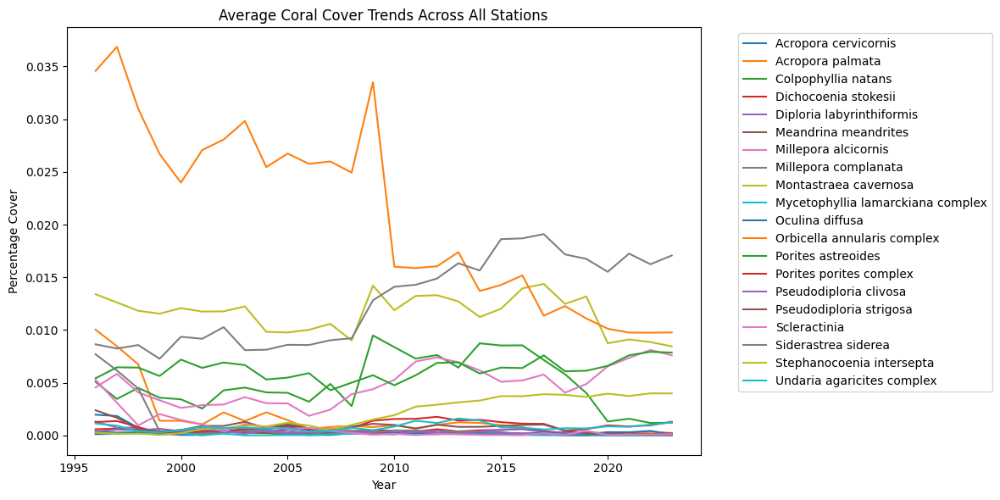

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate annual means across all stations
annual_means = df.groupby('Year')[species].mean()

# Plotting
plt.figure(figsize=(12, 6))
for sp in species:
    if (annual_means[sp]>0).all():
        sns.lineplot(data=annual_means, x=annual_means.index, y=sp,
                    label=sp.replace('_', ' '), alpha=1)
plt.title('Average Coral Cover Trends Across All Stations')
plt.ylabel('Percentage Cover')
plt.xlabel('Year')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [5]:

melt_df = df.melt(id_vars=['Year'], value_vars=species,
                 var_name='Species', value_name='Cover')

fig = px.line(melt_df, x='Year', y='Cover', color='Species',
             line_group='Species', hover_name='Species',
             title='Interactive Coral Cover Trends')
fig.show()


In [7]:
melt_df = df.melt(id_vars=['StationID', 'Year'], value_vars=species,
                 var_name='Species', value_name='Cover')

# Create an interactive plot
fig = px.line(melt_df, x='Year', y='Cover', color='Species',
              line_group='StationID', hover_name='StationID',
              title='Interactive Coral Cover Trends Across Stations')
fig.update_layout(xaxis_title='Year', yaxis_title='Percentage Cover')
fig.show()

In [ ]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output

app = dash.Dash(__name__)

app.layout = html.Div([
    html.H1('Stony Coral PCover per species ',
            style={
        'color': 'white',           # text color
        'fontFamily': 'Arial, sans-serif',  # font family
        'fontSize': '36px'         # font size
    }),
    dcc.Dropdown(id='species-dropdown', options=[{'label': sp, 'value': sp} for sp in species]),
    dcc.Graph(id='cover-graph')
])

@app.callback(
    Output('cover-graph', 'figure'),
    [Input('species-dropdown', 'value')]
)
def update_graph(selected_species):
    filtered_df = melt_df[melt_df['Species'] == selected_species]
    fig = px.line(filtered_df, x='Year', y='Cover', line_group='StationID', hover_name='StationID', color='StationID')
    return fig

if __name__ == '__main__':
    app.run(debug=True)


## Identify and interpret trends in species richness of stony corals over the years.

#### count

In [4]:
path = 'dataset/'
count = pd.read_csv(path+'CREMP_SCOR_Summaries_2023_Counts.csv')
count.columns

Index(['Year', 'Date', 'Subregion', 'Habitat', 'SiteID', 'Site_name',
       'StationID', 'Acropora_cervicornis', 'Acropora_palmata',
       'Acropora_prolifera', 'Agaricia_fragilis', 'Agaricia_lamarcki',
       'Cladocor_arbuscula', 'Colpophyllia_natans', 'Dendrogyra_cylindrus',
       'Dichocoenia_stokesii', 'Diploria_labyrinthiformis',
       'Eusmilia_fastigiata', 'Favia_fragum', 'Helioseris_cucullata',
       'Isophyllia_rigida', 'Isophyllia_sinuosa', 'Madracis_aurentenra',
       'Madracis_decactis', 'Madracis_pharensis', 'Madracis_scenaria',
       'Madracis_sp', 'Manicina_areolata', 'Meandrina_meandrites',
       'Millepora_complanata', 'Montastraea_cavernosa', 'Mussa_angulosa',
       'Mycetophyllia_aliciae', 'Mycetophyllia_danaana', 'Mycetophyllia_ferox',
       'Mycetophyllia_lamarckiana', 'Mycetophyllia_sp', 'Oculina_diffusa',
       'Oculina_robusta', 'Orbicella_annularis_complex', 'Orbicella_faveolata',
       'Orbicella_franksi', 'Phyllangia_americana', 'Porites_astreoid

In [ ]:
columns=['Year','Acropora_cervicornis', 'Acropora_palmata',
       'Acropora_prolifera', 'Agaricia_fragilis', 'Agaricia_lamarcki',
       'Cladocor_arbuscula', 'Colpophyllia_natans', 'Dendrogyra_cylindrus',
       'Dichocoenia_stokesii', 'Diploria_labyrinthiformis',
       'Eusmilia_fastigiata', 'Favia_fragum', 'Helioseris_cucullata',
       'Isophyllia_rigida', 'Isophyllia_sinuosa', 'Madracis_aurentenra',
       'Madracis_decactis', 'Madracis_pharensis', 'Madracis_scenaria',
       'Madracis_sp', 'Manicina_areolata', 'Meandrina_meandrites',
       'Millepora_complanata', 'Montastraea_cavernosa', 'Mussa_angulosa',
       'Mycetophyllia_aliciae', 'Mycetophyllia_danaana', 'Mycetophyllia_ferox',
       'Mycetophyllia_lamarckiana', 'Mycetophyllia_sp', 'Oculina_diffusa',
       'Oculina_robusta', 'Orbicella_annularis_complex', 'Orbicella_faveolata',
       'Orbicella_franksi', 'Phyllangia_americana', 'Porites_astreoides',
       'Porites_branneri', 'Porites_porites', 'Pseudodiploria_clivosa',
       'Pseudodiploria_strigosa', 'Scleractinia', 'Scolymia_cubensis',
       'Scolymia_lacera', 'Siderastrea_radians', 'Siderastrea_siderea',
       'Solenastrea_bournoni', 'Solenastrea_hyades',
       'Stephanocoenia_intersepta', 'Undaria_agaricites_complex']

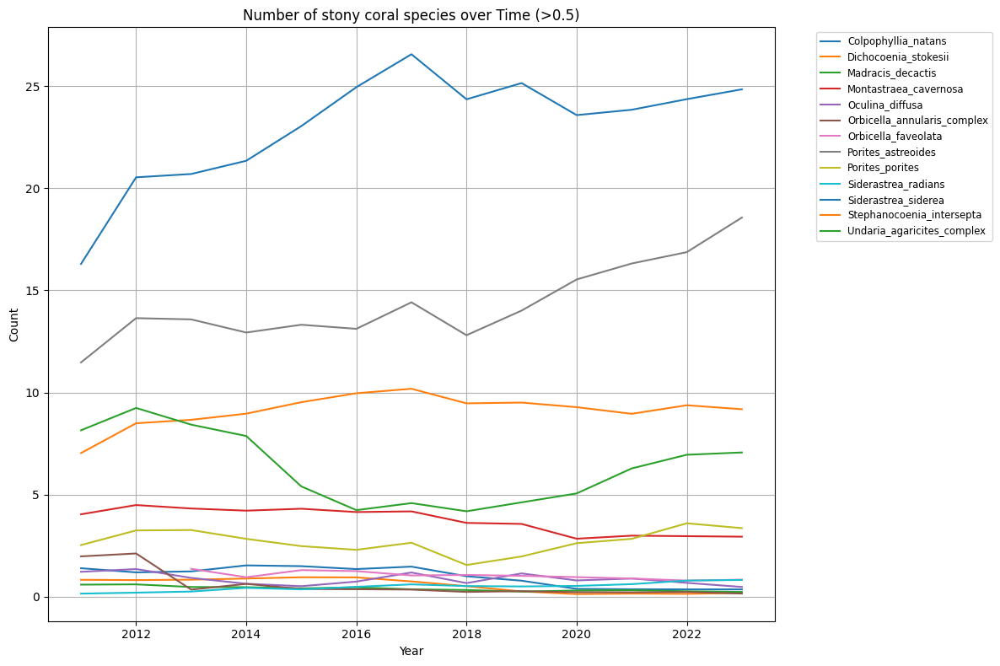

In [ ]:
count = pd.read_csv(path+'CREMP_SCOR_Summaries_2023_Counts.csv')

grouped_data = count[columns].groupby(['Year']).mean().reset_index()

plt.figure(figsize=(12, 8))
for sp in columns:
  if (sp != 'Year') and  (grouped_data[sp]>0.5).any():
    plt.plot(
        grouped_data['Year'],
        grouped_data[sp],
        label=f'{sp}'
    )
plt.title(f'Number of stony coral species over Time (>0.5)')
plt.xlabel('Year')
plt.ylabel('Count')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')  # Adjust legend placement
plt.grid()
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

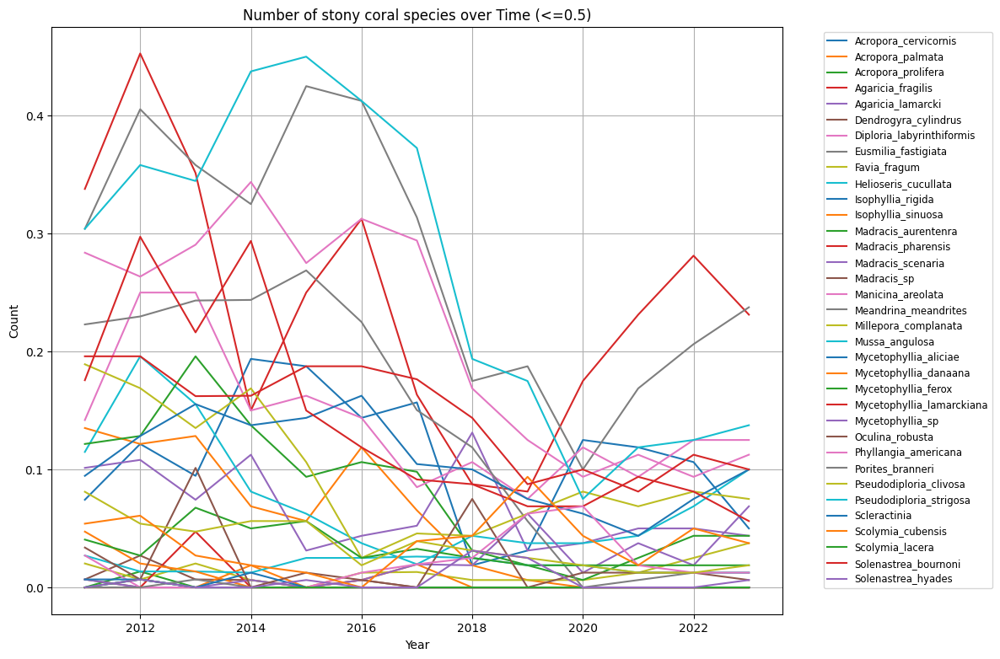

In [ ]:
count = pd.read_csv(path+'CREMP_SCOR_Summaries_2023_Counts.csv')

grouped_data = count[columns].groupby(['Year']).mean().reset_index()

plt.figure(figsize=(12, 8))
for sp in columns:
  if (sp != 'Year') and  (grouped_data[sp]<=0.5).all():
    plt.plot(
        grouped_data['Year'],
        grouped_data[sp],
        label=f'{sp}'
    )
plt.title(f'Number of stony coral species over Time (<=0.5)')
plt.xlabel('Year')
plt.ylabel('Count')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')  # Adjust legend placement
plt.grid()
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

#### dens

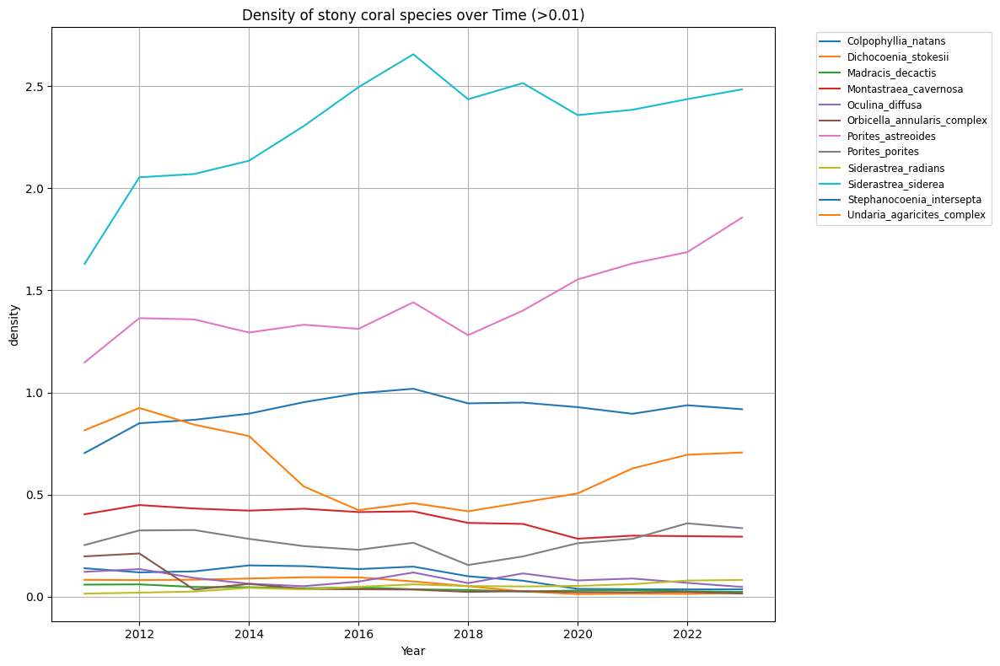

In [ ]:
dens = pd.read_csv(path+'CREMP_SCOR_Summaries_2023_Density.csv')

columns=['Year','Acropora_cervicornis', 'Acropora_palmata',
       'Acropora_prolifera', 'Agaricia_fragilis', 'Agaricia_lamarcki',
       'Colpophyllia_natans', 'Dendrogyra_cylindrus',
       'Dichocoenia_stokesii', 'Diploria_labyrinthiformis',
       'Eusmilia_fastigiata', 'Favia_fragum', 'Helioseris_cucullata',
       'Isophyllia_rigida', 'Isophyllia_sinuosa', 'Madracis_aurentenra',
       'Madracis_decactis', 'Madracis_pharensis', 'Madracis_scenaria',
       'Madracis_sp', 'Manicina_areolata', 'Meandrina_meandrites',
       'Millepora_complanata', 'Montastraea_cavernosa', 'Mussa_angulosa',
       'Mycetophyllia_aliciae', 'Mycetophyllia_danaana', 'Mycetophyllia_ferox',
       'Mycetophyllia_lamarckiana', 'Mycetophyllia_sp', 'Oculina_diffusa',
       'Oculina_robusta', 'Orbicella_annularis_complex', 'Orbicella_faveolata',
       'Orbicella_franksi', 'Phyllangia_americana', 'Porites_astreoides',
       'Porites_branneri', 'Porites_porites', 'Pseudodiploria_clivosa',
       'Pseudodiploria_strigosa', 'Scleractinia', 'Scolymia_cubensis',
       'Scolymia_lacera', 'Siderastrea_radians', 'Siderastrea_siderea',
       'Solenastrea_bournoni', 'Solenastrea_hyades',
       'Stephanocoenia_intersepta', 'Undaria_agaricites_complex']
grouped_data = dens[columns].groupby(['Year']).mean().reset_index()

plt.figure(figsize=(12, 8))
for sp in columns:
  if sp != 'Year' and  (grouped_data[sp]>0.01).all():
    plt.plot(
        grouped_data['Year'],
        grouped_data[sp],
        label=f'{sp}'
    )
plt.title(f'Density of stony coral species over Time (>0.01)')
plt.xlabel('Year')
plt.ylabel('density')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')  # Adjust legend placement
plt.grid()
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

#### raw data

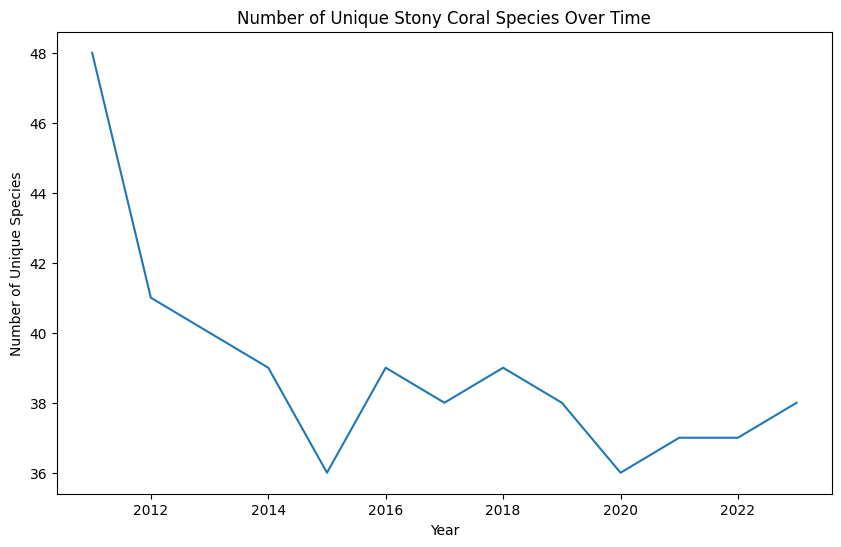

In [19]:
raw = pd.read_csv(path+'CREMP_SCOR_RawData_2023.csv')
species_richness = raw.groupby('Year')['SPP_CODE'].nunique().reset_index()
plt.figure(figsize=(10, 6))
sns.lineplot(data=species_richness, x='Year', y='SPP_CODE')
plt.title('Number of Unique Stony Coral Species Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Unique Species')
plt.show()

In [15]:
raw['SPP_CODE'].nunique()

60

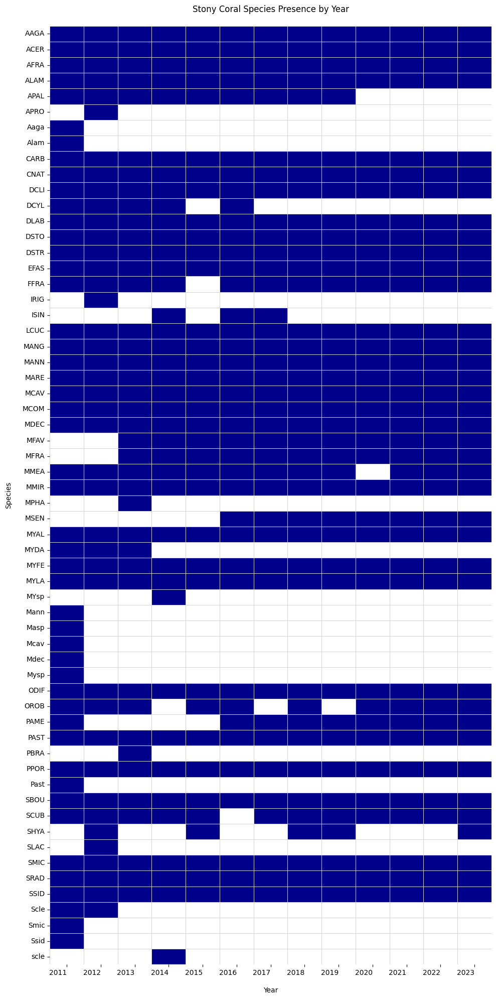

In [17]:
species_richness = raw.groupby('Year')['SPP_CODE'].unique().explode().reset_index()
presence_matrix = pd.crosstab(
    species_richness['Year'],
    species_richness['SPP_CODE']
)

# Configure visualization
plt.figure(figsize=(10, 20))
sns.heatmap(
    presence_matrix.T,  # Transpose for species on y-axis
    cmap=['white', 'darkblue'],
    cbar=False,
    linewidths=0.5,
    linecolor='lightgray'
)

plt.title('Stony Coral Species Presence by Year', pad=20)
plt.xlabel('Year', labelpad=15)
plt.ylabel('Species', labelpad=15)
plt.xticks( ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


## Examine how the density of octocoral species varies across stations and over time.

In [5]:
path = 'dataset/'
df= pd.read_csv(path+'CREMP_OCTO_Summaries_2023_Density.csv')
df.columns

Index(['Year', 'Date', 'Subregion', 'Habitat', 'SiteID', 'Site_name',
       'StationID', 'Eunicea_calyculata', 'Gorgonia_ventalina',
       'Pseudopterogorgia_americana', 'Pseudopterogorgia_bipinnata',
       'Eunicea_flexuosa', 'Pseudoplexaura_porosa', 'Total_Octocorals'],
      dtype='object')

In [ ]:
df['StationID'].nunique()

84

In [ ]:
df['Site_name'].nunique()


21

In [6]:
desnsity= ['Eunicea_calyculata', 'Gorgonia_ventalina',
       'Pseudopterogorgia_americana', 'Pseudopterogorgia_bipinnata',
       'Eunicea_flexuosa', 'Pseudoplexaura_porosa', 'Total_Octocorals']
df['Total_Density'] = df[desnsity].sum(axis=1)
desnsity= desnsity 
columns = desnsity + ['Year', 'StationID', 'Site_name', 'Total_Density']



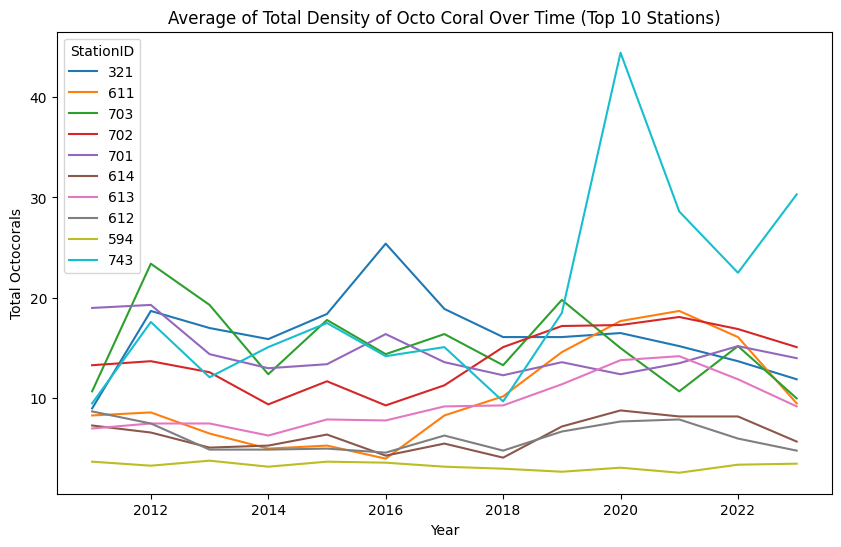

In [11]:
species_richness = df.groupby(['StationID', 'Year'])['Total_Octocorals'].mean().reset_index()

# Get top 10 most frequent stations
top_stations = df['StationID'].value_counts().nlargest(10).index

# Filter data for top 10 stations only
filtered_species_richness = species_richness[species_richness['StationID'].isin(top_stations)]

# Plot
plt.figure(figsize=(10, 6))
for st in top_stations:
    data=filtered_species_richness[filtered_species_richness['StationID']==st]
    plt.plot(data['Year'], data['Total_Octocorals'], label = st )
plt.title('Average of Total Density of Octo Coral Over Time (Top 10 Stations)')
plt.xlabel('Year')
plt.ylabel('Total Octocorals')
plt.legend(title='StationID')
plt.show()


In [9]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output

app = dash.Dash(__name__)

app.layout = html.Div([
    html.H1('Octo Coral desnsity Trends Across Stations ',
            style={
        'color': 'white',           # text color
        'fontFamily': 'Arial, sans-serif',  # font family
        'fontSize': '30px'         # font size
    }),
    dcc.Dropdown(id='species-dropdown', options=[{'label': dens, 'value': dens} for dens in desnsity]),
    dcc.Graph(id='cover-graph')
])
top_stations = melt_df['StationID'].value_counts().nlargest(20).index

@app.callback(
    Output('cover-graph', 'figure'),
    [Input('species-dropdown', 'value')]
)
def update_graph(desnsity):
    filtered_df = melt_df[
        (melt_df['desnsity'] == desnsity) & 
        (melt_df['StationID'].isin(top_stations))
    ]
    fig = px.line(filtered_df, x='Year', y='Cover', line_group='StationID', hover_name='StationID', color='StationID')
    return fig

if __name__ == '__main__':
    app.run(debug=True)


#### station

In [ ]:
grouped_data = df[columns].groupby(['Year', 'StationID']).mean().reset_index()
# Plotting the evolution of stony coral percentage cover across different stations

# Loop through unique stations to plot data for each station
for station in grouped_data['StationID'].unique():
    plt.figure(figsize=(8,6))
    station_data = grouped_data[grouped_data['StationID'] == station]
    for sp in species:
      plt.plot(
          station_data['Year'],
          station_data[sp],
          label=f'{sp}'
      )
    # Adding titles and labels
    plt.title(f'Evolution of density of octocoral species across stations {station}')
    plt.xlabel('Year')
    plt.ylabel('Percentage Cover')
    plt.legend( loc='upper right', fontsize='small')  # Adjust legend placement
    plt.grid()
    plt.tight_layout()  # Adjust layout to prevent overlap
    plt.show()

In [ ]:
grouped_data = df[['Year', 'StationID', 'Total_Octocorals']].groupby(['Year', 'StationID']).mean().reset_index()
# # Plotting the evolution of stony coral percentage cover across different stations

# Loop through unique stations to plot data for each station
plt.figure(figsize=(10,8))

for station in grouped_data['StationID'].unique():
    station_data = grouped_data[grouped_data['StationID'] == station]
    plt.plot(
        station_data['Year'],
        station_data['Total_Octocorals'],
        label=f'station-{station}'
    )
    # Adding titles and labels
plt.title(f'Evolution of density of octocoral species across stations {station}')
plt.xlabel('Year')
plt.ylabel('Percentage Cover')
plt.legend( loc='upper right', fontsize='small')  # Adjust legend placement
plt.grid()
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

#### site name

In [ ]:
grouped_data = df[columns].groupby(['Year', 'Site_name']).mean().reset_index()
# Plotting the evolution of stony coral percentage cover across different stations

# Loop through unique stations to plot data for each station
for station in grouped_data['Site_name'].unique():
    plt.figure(figsize=(8,6))
    station_data = grouped_data[grouped_data['Site_name'] == station]
    for sp in species:
      plt.plot(
          station_data['Year'],
          station_data[sp],
          label=f'{sp}'
      )
    # Adding titles and labels
    plt.title(f'Evolution of density of octocoral species across site {station}')
    plt.xlabel('Year')
    plt.ylabel('Percentage Cover')
    plt.legend( loc='upper right', fontsize='small')  # Adjust legend placement
    plt.grid()
    plt.tight_layout()  # Adjust layout to prevent overlap
    plt.show()

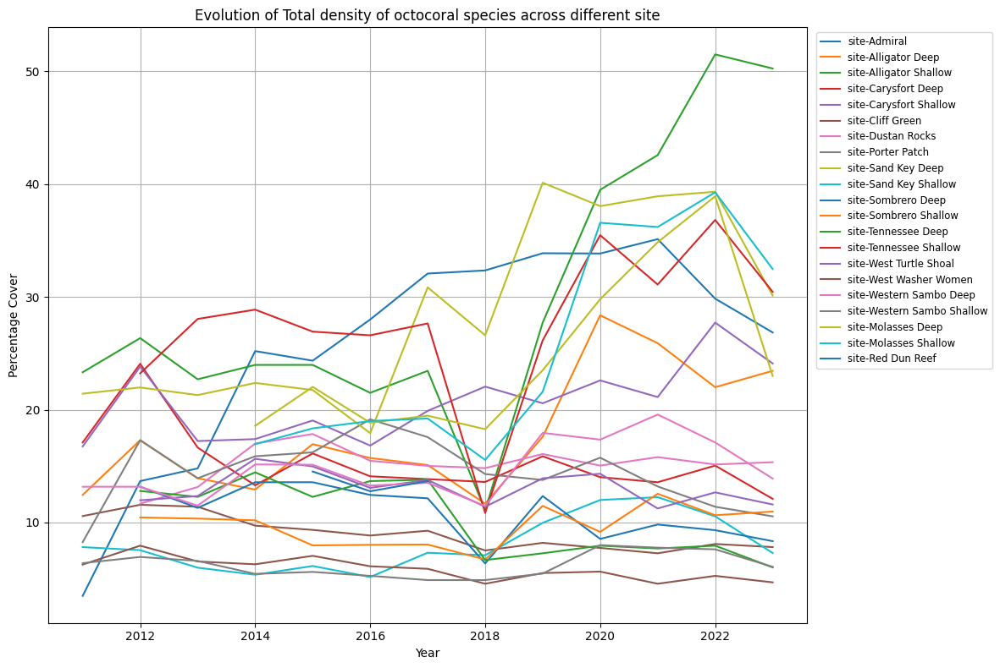

In [ ]:
grouped_data = df[['Year', 'Site_name', 'Total_Octocorals']].groupby(['Year', 'Site_name']).mean().reset_index()
# # Plotting the evolution of stony coral percentage cover across different stations

# Loop through unique stations to plot data for each station
plt.figure(figsize=(12,8))

for station in grouped_data['Site_name'].unique():
    station_data = grouped_data[grouped_data['Site_name'] == station]
    plt.plot(
        station_data['Year'],
        station_data['Total_Octocorals'],
        label=f'site-{station}'
    )
    # Adding titles and labels
plt.title(f'Evolution of Total density of octocoral species across different site')
plt.xlabel('Year')
plt.ylabel('Percentage Cover')
plt.legend(bbox_to_anchor=(1.25, 1), loc='upper right', fontsize='small')  # Adjust legend placement
plt.grid()
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

## Determine whether there are significant differences in the living tissue area of stony corals between monitoring sites.


In [29]:
from scipy.stats import kruskal, f_oneway
from statsmodels.stats.multicomp import pairwise_tukeyhsd

ModuleNotFoundError: No module named 'statsmodels'

In [28]:
df= pd.read_csv(path+'CREMP_SCOR_Summaries_2023_LTA.csv')
species_columns = df.columns[6:]  # All species columns
df['Total_Tissue_Area'] = df[species_columns].sum(axis=1)
site_data = df.groupby('Site_name')['Total_Tissue_Area'].apply(list).reset_index()

In [ ]:
f_stat, p_value = f_oneway(*site_data['Total_Tissue_Area'])
print(f"ANOVA p-value: {p_value:.4f}")

# Post-hoc Tukey HSD
tukey = pairwise_tukeyhsd(
    endog=df['Total_Tissue_Area'],
    groups=df['Site_name'],
    alpha=0.05
)
print(tukey.summary())

In [ ]:
# Kruskal-Wallis test
h_stat, p_value = kruskal(*site_data['Total_Tissue_Area'])
print(f"Kruskal-Wallis p-value: {p_value:.4f}")

# Post-hoc Dunn's test with Bonferroni correction
from scikit_posthocs import posthoc_dunn
dunn_results = posthoc_dunn(df, val_col='Total_Tissue_Area', group_col='Site_name')


In [ ]:
plt.figure(figsize=(14, 8))
sns.boxplot(
    data=df,
    x='Site_name',
    y='Total_Tissue_Area',
    palette='viridis'
)
plt.xticks(rotation=45, ha='right')
plt.title('Living Tissue Area Distribution by Monitoring Site')
plt.ylabel('Total Tissue Area (cm²)')
plt.xlabel('Monitoring Site')
plt.tight_layout()
plt.show()


In [ ]:
# If coordinate data exists
site_agg = df.groupby('Site_name').agg({
    'Total_Tissue_Area': 'mean',
    'Latitude': 'first',
    'Longitude': 'first'
})

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=site_agg,
    x='Longitude',
    y='Latitude',
    size='Total_Tissue_Area',
    hue='Total_Tissue_Area',
    palette='viridis',
    sizes=(50, 300)
)
plt.title('Geographic Distribution of Coral Tissue Area')
plt.colorbar(label='Mean Tissue Area (cm²)')


In [ ]:
# Plot post-hoc results
tukey.plot_simultaneous(
    comparison_name=site_data['Site_name'].iloc[0],
    figsize=(10, 6)
)
plt.title('Tukey HSD Group Comparisons')


In [ ]:
# Normality test
from scipy.stats import shapiro
print(shapiro(df['Total_Tissue_Area']))

# Homoscedasticity
from scipy.stats import levene
print(levene(*site_data['Total_Tissue_Area']))


In [ ]:
import plotly.express as px

fig = px.parallel_categories(
    df,
    dimensions=['Subregion', 'Habitat', 'Site_name'],
    color='Total_Tissue_Area',
    title='Tissue Area Distribution Across Site Characteristics'
)
fig.show()


## Assess spatial patterns in the distribution of different coral species and how these patterns change over time.